# Breast Invasive Carcinoma (Sanger, Nature 2012)

*“The landscape of cancer genes and mutational processes in breast cancer”* , Stephens et al.

The coding exons of 21,416 protein coding genes and 1,664 microRNAs were sequenced and copy number changes examined in **100 primary breast cancers**, 79 of which were Estrogen Receptor positive (ER+) and 21 of which were Estrogen Receptor negative (ER−). Stephens et al. found strong correlations between mutation number, age at which cancer was diagnosed and cancer histological grade, and observed multiple mutational signatures. Among the 100 tumors, they found driver mutations in at least 40 cancer genes and 73 different combinations of mutated cancer genes. 
Driver mutations were identified in several new cancer genes including AKT2, ARID1B, CASP8, CDKN1B, MAP3K1, MAP3K13, NCOR1, SMARCD1 and TBX3. 

In [24]:
import os

In [25]:
os.chdir("C:/Users/Cristina/OneDrive/Documenti/BCG/Tesi/Datasets/Breast Invasive Carcinoma (Sanger, Nature 2012)")

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import ydata_profiling as yp
from ydata_profiling import ProfileReport

## Patients clinical data 

In [27]:
data_clinical_patient=pd.read_csv('data_clinical_patient.csv', sep=None, engine='python')
data_clinical_patient

,PATIENT_ID,SEX,AGE,HISTOPATHOLOGY
0,PD3849a,Female,82,Classic-alveolar lobular
1,PD3852a,Female,75,Mucinous
2,PD3854a,Female,86,Mucinous
3,PD3856a,Female,66,Mixed
4,PD3857a,Female,48,Ductal
...,...,...,...,...
95,PD4935a,Female,56,Ductal
96,PD4936a,Female,70,Ductal
97,PD4937a,Female,60,Ductal
98,PD4938a,Female,55,Ductal


#### Select ductal BC patients 

In [28]:
ductal_pts = data_clinical_patient.loc[data_clinical_patient['HISTOPATHOLOGY']=='Ductal']
ductal_pts

,PATIENT_ID,SEX,AGE,HISTOPATHOLOGY
4,PD3857a,Female,48,Ductal
5,PD3858a,Female,76,Ductal
8,PD3985a,Female,63,Ductal
9,PD3986a,Female,48,Ductal
10,PD3987a,Female,49,Ductal
...,...,...,...,...
95,PD4935a,Female,56,Ductal
96,PD4936a,Female,70,Ductal
97,PD4937a,Female,60,Ductal
98,PD4938a,Female,55,Ductal


In [29]:
ductal_pts = ductal_pts[['PATIENT_ID']]
ductal_pts 

,PATIENT_ID
4,PD3857a
5,PD3858a
8,PD3985a
9,PD3986a
10,PD3987a
...,...
95,PD4935a
96,PD4936a
97,PD4937a
98,PD4938a


In [30]:
profile_patient = ProfileReport(data_clinical_patient, title="Pandas Profiling Report")

In [31]:
profile_patient

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The observations (patients) are 100. All the patients are females. The youngest patient is 27, whereas the older patient is 93. The average age is 56. 
The majority of the cohort is affected by ductal carcinoma (76%).

## Samples clinical data 

In [32]:
data_clinical_sample=pd.read_csv('data_clinical_sample.csv', sep=None, engine='python')
print(data_clinical_sample)

   PATIENT_ID SAMPLE_ID  TUBULE_SCORE  PLEOMORPHISM_SCORE  MITOTIC_SCORE  \
0     PD3849a   PD3849a           3.0                 2.0            1.0   
1     PD3852a   PD3852a           2.0                 2.0            1.0   
2     PD3854a   PD3854a           3.0                 2.0            3.0   
3     PD3856a   PD3856a           2.0                 3.0            1.0   
4     PD3857a   PD3857a           3.0                 3.0            3.0   
..        ...       ...           ...                 ...            ...   
95    PD4935a   PD4935a           3.0                 3.0            3.0   
96    PD4936a   PD4936a           3.0                 3.0            3.0   
97    PD4937a   PD4937a           3.0                 3.0            3.0   
98    PD4938a   PD4938a           3.0                 3.0            2.0   
99    PD4939a   PD4939a           NaN                 NaN            NaN   

    MITOTIC_COUNT GRADE ER_STATUS PR_STATUS HER2_STATUS  \
0             1.0    II     

In [33]:
profile_sample = ProfileReport(data_clinical_sample, title="Pandas Profiling Report")

In [34]:
profile_sample

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In the sample dataset, there are 3 types of score (they are semiquantitative methods for assessing histological grade in breast cancer):

1. Tubule score variable (9% of missing values): this score represents the percent of cancer cells that are formed into tubules. A score of 1 means more than 75% of cells are in tubule formation. A score of 2 is between 10 and 75%. A score of 3 is used when less than 10% of cells are in tubule formation. In the dataset the 70% of the samples have a tubule score of 3. 
2. Pleomorphism score (10% of missing values): a score of 1 represents small, regular, uniform cells; a score of 2 means a moderate increase in cells size and variability; a score of 3 is used when there is a marked variation in the cells. The 54% of the samples have a pleomorphism score of 3.
3. Mitotic score (10% missing values): it describes how quickly the cancer cells are multiplying or dividing using a 1 to 3 scale: 1 being the slowest, 3 the quickest. 42.2% of the samples have 1 score; 40% have 3 score.

The general grade too is present: only the 8% of the samples have grade I, the others have II and III grades. 
The ER, PR and HER2 status are present:  79 of the samples are Estrogen Receptor positive (ER+) and 21 of them are Estrogen Receptor negative (ER−).

In [35]:
# keep only the relevant variables: 
data_clinical_sample_relevant=data_clinical_sample.drop(['ONCOTREE_CODE', 'CANCER_TYPE', 'CANCER_TYPE_DETAILED', 'TUMOR_PLOIDY'],axis=1)

#### Select ductal TNBC patients 

In [36]:
TN_pts=data_clinical_sample_relevant.loc[(data_clinical_sample_relevant['ER_STATUS']=='-ve')&(data_clinical_sample_relevant['PR_STATUS']=='-ve')&(data_clinical_sample_relevant['HER2_STATUS']=='-ve')]
TN_pts

,PATIENT_ID,SAMPLE_ID,TUBULE_SCORE,PLEOMORPHISM_SCORE,MITOTIC_SCORE,MITOTIC_COUNT,GRADE,ER_STATUS,PR_STATUS,HER2_STATUS,ABERRANT_CELL_FRACTION,TMB_NONSYNONYMOUS
10,PD3987a,PD3987a,NaN,NaN,NaN,NaN,III,-ve,-ve,-ve,0.72,0.933333333333
24,PD4002a,PD4002a,3.0,3.0,3.0,110.0,III,-ve,-ve,-ve,0.43,303.333.333.333
25,PD4003a,PD4003a,3.0,3.0,3.0,48.0,III,-ve,-ve,-ve,0.46,303.333.333.333
33,PD4091a,PD4091a,2.0,3.0,3.0,48.0,III,-ve,-ve,-ve,0.25,0.933333333333
37,PD4098a,PD4098a,3.0,2.0,3.0,22.0,III,-ve,-ve,-ve,0.47,253.333.333.333
46,PD4107a,PD4107a,3.0,3.0,3.0,72.0,III,-ve,-ve,-ve,0.56,193.333.333.333
48,PD4109a,PD4109a,3.0,3.0,3.0,32.0,III,-ve,-ve,-ve,0.50,3.1
52,PD4113a,PD4113a,3.0,2.0,1.0,2.0,II,-ve,-ve,-ve,0.63,0.933333333333
65,PD4130a,PD4130a,3.0,3.0,3.0,36.0,III,-ve,-ve,-ve,0.42,0.966666666667
68,PD4133a,PD4133a,NaN,NaN,NaN,NaN,III,-ve,-ve,-ve,0.83,203.333.333.333


In [37]:
TN_pts = TN_pts[['PATIENT_ID']]
TN_pts

,PATIENT_ID
10,PD3987a
24,PD4002a
25,PD4003a
33,PD4091a
37,PD4098a
46,PD4107a
48,PD4109a
52,PD4113a
65,PD4130a
68,PD4133a


In [38]:
len(TN_pts)

14

In [39]:
# select patients both TN and DC
TN_ductal_pts = pd.merge(ductal_pts, TN_pts, how='inner', on=['PATIENT_ID'])
TN_ductal_pts

,PATIENT_ID
0,PD3987a
1,PD4002a
2,PD4003a
3,PD4091a
4,PD4107a
5,PD4109a
6,PD4113a
7,PD4130a
8,PD4133a
9,PD4200a


In [40]:
len(TN_ductal_pts)

13

#### Select ductal non-TNBC patients 

In [41]:
# select the IDC patients not TN
x = pd.concat([TN_ductal_pts, ductal_pts])
ductal_NON_TN_pts = x.drop_duplicates(keep=False, inplace=False)

## Mutational data 

In [42]:
data_mutation=pd.read_csv('data_mutations_final.csv', sep=None, engine='python')

In [43]:
data_mutation.isin(['SEPT10']).any().any()

False

In [44]:
profile_mutation = ProfileReport(data_mutation, title="Pandas Profiling Report")

In [45]:
profile_mutation

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The MAF file contains 7239 observations (rows) and 133 variables (columns). The mutated distinct genes are 5096. The reference genome used for the alignment (NCBI_Build) is GRCh37 for all the observations.  All the 23 chromosomes harbor mutations, even the sexual chromosome X. **For SNPs, the Start_Position=End_Position.** The 62.9% of the mutations are missense and they are for the 96.2% SNPs.
Protein position variables has 3.6% of missing values (260 samples).

In [46]:
# select the relevant variables from the MAF file
data_mutation_relevant=data_mutation[['Tumor_Sample_Barcode', 'Hugo_Symbol', 'Chromosome', 'Start_Position', 'End_Position', 'Variant_Classification', 'Variant_Type', 'Reference_Allele', 'Tumor_Seq_Allele1', 'Tumor_Seq_Allele2', 'HGVSc', 'HGVSp_Short', 'Protein_position', 'Transcript_ID']]

In this dataset sample IDs and patient IDs are equal.

In [47]:
# check if there are some missing Transcript IDs
data_mutation_relevant['Transcript_ID'].isna().sum()

3

In [48]:
# remove the rows with missing Transcript IDs
data_mutation_relevant=data_mutation_relevant.dropna(subset=['Transcript_ID'])

In [49]:
patient_sample=data_clinical_sample.iloc[:,0:2]
patient_sample

,PATIENT_ID,SAMPLE_ID
0,PD3849a,PD3849a
1,PD3852a,PD3852a
2,PD3854a,PD3854a
3,PD3856a,PD3856a
4,PD3857a,PD3857a
...,...,...
95,PD4935a,PD4935a
96,PD4936a,PD4936a
97,PD4937a,PD4937a
98,PD4938a,PD4938a


#### Associate the patient IDs to the mutation dataset

In [50]:
# adding the patient_ID to the mutation dataset 
data_mutation_sample_pts = data_mutation_relevant.join(patient_sample.set_index('SAMPLE_ID'), on='Tumor_Sample_Barcode')

In [51]:
data_mutation_sample_pts=data_mutation_sample_pts[['Tumor_Sample_Barcode', 'PATIENT_ID','Hugo_Symbol', 'Chromosome', 'Start_Position', 'End_Position', 'Variant_Classification', 'Variant_Type', 'Reference_Allele', 'Tumor_Seq_Allele1', 'Tumor_Seq_Allele2', 'HGVSc', 'HGVSp_Short', 'Protein_position','Transcript_ID']].copy()

In [52]:
data_mutation_sample_pts['Protein_position'].isna().sum()

258

In [53]:
data_mutation_sample_pts.to_csv('mutation_table_Stephens_et_al_Nature_2012.csv')

### Mutation Rate analysis

In [54]:
# reload the dataset with the addition of the gene length
data_mutation_sample_pts_final= pd.read_csv('mutation_table_Stephens_et_al_Nature_2012_FINAL.csv', sep=None, engine='python')
data_mutation_sample_pts_final = data_mutation_sample_pts_final.iloc[:, 1:]

In [55]:
# select the unique mutated patients 
mutated_pts = data_mutation_sample_pts_final['PATIENT_ID'].unique()
mutated_pts = pd.DataFrame(mutated_pts, columns = ['PATIENT_ID'])

In [56]:
# select the mutated TN ductal carcinoma patients 
mutated_TN_ductal_pts = pd.merge(TN_ductal_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

In [57]:
len(mutated_TN_ductal_pts)

13

In [58]:
data_mutation_TN_ductal_pts = pd.merge(TN_ductal_pts, data_mutation_sample_pts_final, how='inner', on=['PATIENT_ID'])

In [59]:
data_mutation_TN_ductal_pts['PATIENT_ID'].nunique()

13

In [60]:
# save the dataset 
data_mutation_TN_ductal_pts.to_csv('mutation_table_Stephens_et_al_Sanger_Nature2012_TN_ductal.csv')

In [61]:
# select the IDC non TN patients
mutated_ductal_NON_TN_pts = pd.merge(ductal_NON_TN_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

In [62]:
data_mutation_NON_TN_ductal_pts = pd.merge(ductal_NON_TN_pts, data_mutation_sample_pts_final, how='inner', on=['PATIENT_ID'])

In [63]:
data_mutation_NON_TN_ductal_pts['PATIENT_ID'].nunique()

63

In [64]:
# save the dataset 
data_mutation_NON_TN_ductal_pts.to_csv('mutation_table_Stephens_et_al_Sanger_Nature2012_NON_TN_ductal.csv')

In [65]:
# select the total ductal carcinoma mutated patients 
total_mutated_ductal_pts = pd.merge(ductal_pts, mutated_pts, how='inner', on=['PATIENT_ID'])

In [66]:
data_mutation_TOTAL_ductal_pts = pd.merge(total_mutated_ductal_pts, data_mutation_sample_pts_final, how='inner', on=['PATIENT_ID'])

In [67]:
data_mutation_TOTAL_ductal_pts['PATIENT_ID'].nunique()

76

In [68]:
# save the dataset 
data_mutation_TOTAL_ductal_pts.to_csv('mutation_table_Stephens_et_al_Sanger_Nature2012_TOTAL_ductal.csv')

In [69]:
# add a column to the dataset representing the mutated bases length (End_Position-Start_Position+1)
data_mutation_sample_pts_final.loc[:, 'Mutation_length'] = data_mutation_sample_pts_final['End_Position']-data_mutation_sample_pts_final['Start_Position']+1

In [70]:
data_mutation_sample_pts_final['PATIENT_ID'].nunique()

100

In [71]:
# extract PATIENT_ID and Mutation_length
pts_mutation_length = data_mutation_sample_pts_final[['PATIENT_ID', 'Mutation_length']]

In [72]:
# group by PATIENT_ID and sum the mutation lengths for each pts
mutation_Stephens_et_al_group_by_pts=pts_mutation_length.groupby(['PATIENT_ID'])['Mutation_length'].sum().reset_index()
mutation_Stephens_et_al_group_by_pts.rename(columns = {'Mutation_length':'Total_sum_mutated_bases'}, inplace = True)

In [73]:
# extract Hugo_Symbol and Gene_length
gene_length_for_each_mutation =data_mutation_sample_pts_final[['Hugo_Symbol', 'Gene_length']]

In [74]:
# look at the number of distinct genes
gene_length_for_each_mutation['Hugo_Symbol'].nunique()

5102

In the dataset, in total 5102 distinct mutated genes are present.

In [75]:
# group by gene (Hugo_Symbol) 
mutation_Stephens_et_al_group_by_gene=gene_length_for_each_mutation.groupby(['Hugo_Symbol'])['Gene_length'].max().reset_index()

In [76]:
# compute the total gene length (for all the genes in the dataset)
total_GeneLength = mutation_Stephens_et_al_group_by_gene['Gene_length'].sum()

In [77]:
# add a column to the dataset representing the mutation rate for each patient (Mutation_rate= Mutation_length/total_gene_length)
mutation_Stephens_et_al_group_by_pts["Mutation_rate"] = mutation_Stephens_et_al_group_by_pts["Total_sum_mutated_bases"]/total_GeneLength

In [78]:
# multiply the Mutation_rate values times 10^6
mutation_Stephens_et_al_group_by_pts["Mutation_rate*10^6"] = mutation_Stephens_et_al_group_by_pts["Mutation_rate"]*1000000

In [79]:
# the PATIENT_IDs are sorted for descending order of mutation rate 
mutation_Stephens_et_al_group_by_pts = mutation_Stephens_et_al_group_by_pts.sort_values(by="Mutation_rate", ascending=False)

In [80]:
patient_mutation_rate=mutation_Stephens_et_al_group_by_pts[['PATIENT_ID', 'Mutation_rate*10^6' ]]

In [81]:
patients=np.arange(0,100,1)
# convert a series into a Numpy array
mutation_rate=mutation_Stephens_et_al_group_by_pts[['Mutation_rate*10^6']].to_numpy()

<IPython.core.display.Javascript object>


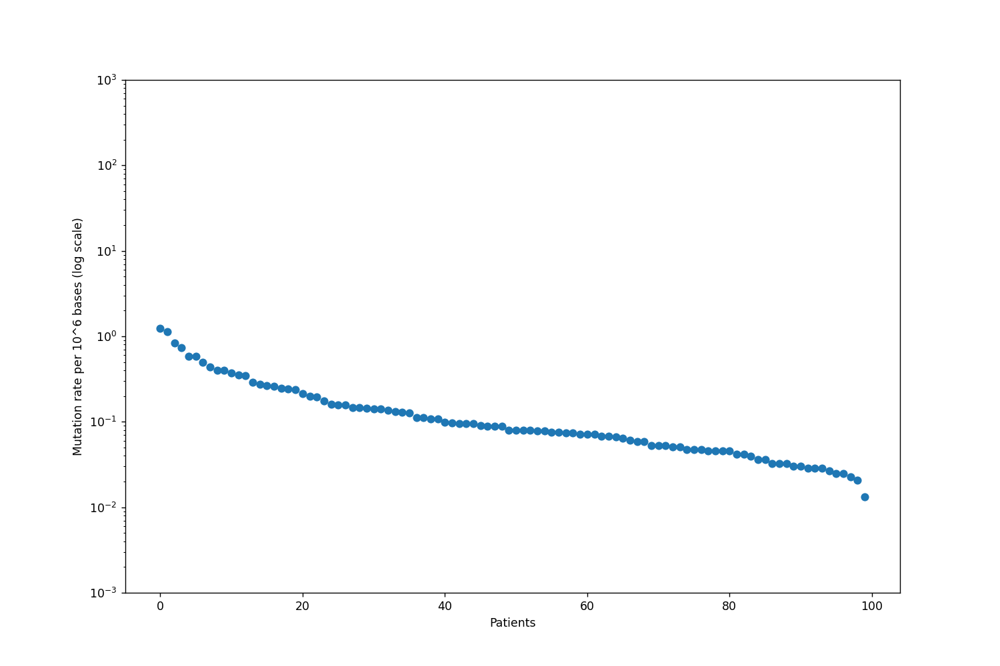

In [82]:
%matplotlib notebook
plt.rcParams['figure.figsize'] = (12, 8)
plt.yscale("log") 
#set axes limit
plt.ylim(0.001, 1000)
plt.scatter(patients, mutation_rate)
plt.xlabel("Patients")
plt.ylabel("Mutation rate per 10^6 bases (log scale)")
plt.show()

### Mutation Frequency analysis

In [83]:
genes_patients=data_mutation_sample_pts_final[['PATIENT_ID', 'Hugo_Symbol']]

In [84]:
n_of_pts_per_gene = genes_patients.groupby(['Hugo_Symbol'])['PATIENT_ID'].count().reset_index()
n_of_pts_per_gene.rename(columns = {'PATIENT_ID':'Num_pts_per_gene'}, inplace = True)

In [85]:
# the total number of patients is 100 
tot_pts = 100 

In [86]:
# add a column to the n_of_pts_per_gene dataframe representing the mutation frequency for each gene
n_of_pts_per_gene["Mutation_frequency (%)"] = (n_of_pts_per_gene["Num_pts_per_gene"]*100)/tot_pts

In [87]:
# the numbers of patients per gene are sorted in descending order
n_of_pts_per_gene = n_of_pts_per_gene.sort_values(by="Num_pts_per_gene", ascending=False)

In [88]:
gene_mutation_frequency = n_of_pts_per_gene[['Hugo_Symbol', 'Mutation_frequency (%)']]

In [89]:
# select the first 50 genes
highest_mutated_genes=gene_mutation_frequency.head(50)

In [90]:
mutated_gene_names=highest_mutated_genes['Hugo_Symbol'].tolist()

<IPython.core.display.Javascript object>


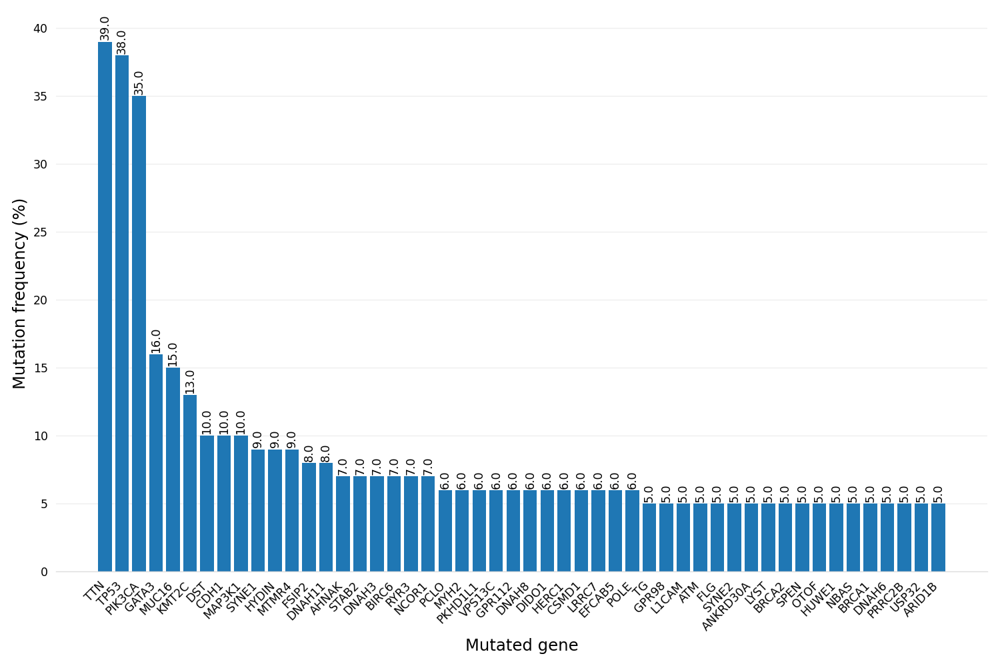

In [91]:
# increase the quality and resolution of the chart
from IPython.display import set_matplotlib_formats
import matplotlib_inline.backend_inline

matplotlib_inline.backend_inline.set_matplotlib_formats('retina')
# set default figure size.
plt.rcParams['figure.figsize'] = (12, 8)
fig, ax = plt.subplots()
h=ax.bar(highest_mutated_genes['Hugo_Symbol'], highest_mutated_genes['Mutation_frequency (%)'], label=mutated_gene_names)
xticks_pos = [0.65*patch.get_width() + patch.get_xy()[0] for patch in h]

_ = plt.xticks(xticks_pos, mutated_gene_names,  ha='right', rotation=45)
#plt.title('Highest mutated genes', fontsize=14)
plt.xlabel('Mutated gene', fontsize=14)
plt.ylabel('Mutation frequency (%)', fontsize=14)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

# Add text annotations to the top of the bars.
# Note, you'll have to adjust this slightly (the 0.3)
# with different data.
for bar in h:
  ax.text(
      bar.get_x() + bar.get_width() / 2,
      bar.get_height() + 0.3,
      round(bar.get_height(), 1),
      rotation='vertical',
      horizontalalignment='center'
  )


fig.tight_layout()

### Normalized Mutation Frequency analysis

In [92]:
# adding the gene length to the gene_mutation_frequency dataset 
gene_mutation_frequency_gene_length = gene_mutation_frequency.join(mutation_Stephens_et_al_group_by_gene.set_index('Hugo_Symbol'), on='Hugo_Symbol')

In [93]:
# add a column to the gene_mutation_frequency_gene_length dataframe representing the mutation frequency for each gene, that is normalized based on the gene length
gene_mutation_frequency_gene_length["Normalized mutation frequency per 10^6"] = (gene_mutation_frequency_gene_length["Mutation_frequency (%)"]/gene_mutation_frequency_gene_length["Gene_length"])*10000

In [94]:
gene_normalized_mutation_frequency = gene_mutation_frequency_gene_length[['Hugo_Symbol', 'Normalized mutation frequency per 10^6']]

In [95]:
# the Normalized mutation frequency per gene is sorted in descending order
gene_normalized_mutation_frequency = gene_normalized_mutation_frequency.sort_values(by="Normalized mutation frequency per 10^6", ascending=False)

In [96]:
# select the first 50 genes
highest_mutated_genes_normalized_frequency=gene_normalized_mutation_frequency.head(50)

In [97]:
mutated_gene_names=highest_mutated_genes_normalized_frequency['Hugo_Symbol'].tolist()

<IPython.core.display.Javascript object>


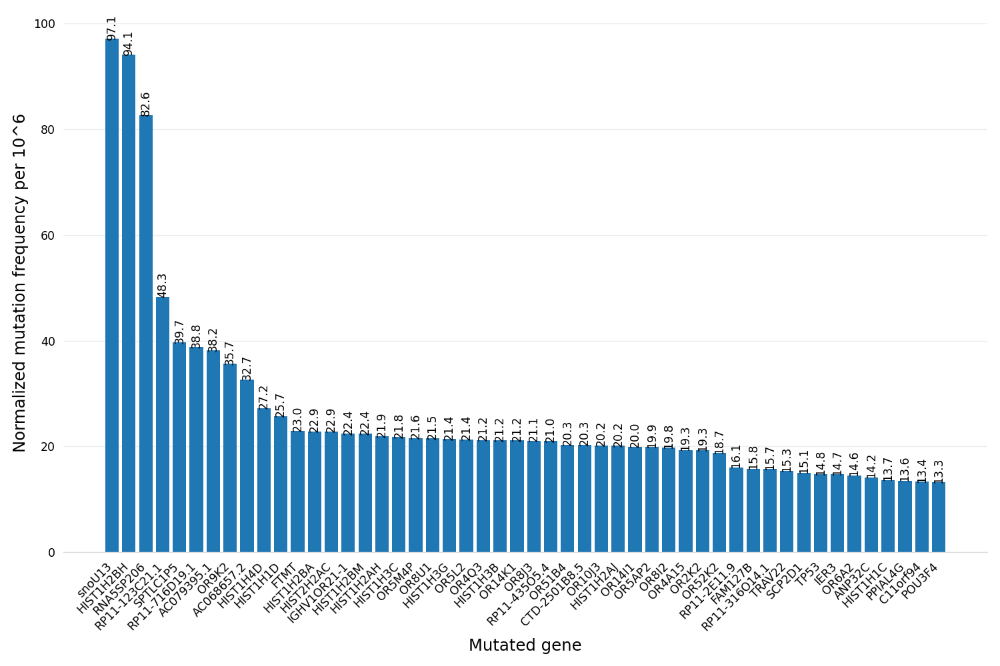

In [98]:
# increase the quality and resolution of the chart
from IPython.display import set_matplotlib_formats
import matplotlib_inline.backend_inline

matplotlib_inline.backend_inline.set_matplotlib_formats('retina')
# set default figure size.
plt.rcParams['figure.figsize'] = (12, 8)
fig, ax = plt.subplots()
h=ax.bar(highest_mutated_genes_normalized_frequency['Hugo_Symbol'], highest_mutated_genes_normalized_frequency['Normalized mutation frequency per 10^6'], label=mutated_gene_names)
xticks_pos = [0.65*patch.get_width() + patch.get_xy()[0] for patch in h]

_ = plt.xticks(xticks_pos, mutated_gene_names,  ha='right', rotation=45)
#plt.title('Highest mutated genes', fontsize=14)
plt.xlabel('Mutated gene', fontsize=14)
plt.ylabel('Normalized mutation frequency per 10^6', fontsize=14)


# First, let's remove the top, right and left spines (figure borders)
# which really aren't necessary for a bar chart.
# Also, make the bottom spine gray instead of black.
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_color('#DDDDDD')

# Second, remove the ticks as well.
ax.tick_params(bottom=False, left=False)

# Third, add a horizontal grid (but keep the vertical grid hidden).
# Color the lines a light gray as well.
ax.set_axisbelow(True)
ax.yaxis.grid(True, color='#EEEEEE')
ax.xaxis.grid(False)

# Add text annotations to the top of the bars.
# Note, you'll have to adjust this slightly (the 0.3)
# with different data.
for bar in h:
  ax.text(
      bar.get_x() + bar.get_width() / 2,
      bar.get_height() + 0.3,
      round(bar.get_height(), 1),
      rotation='vertical',
      horizontalalignment='center'
  )


fig.tight_layout()